In [1]:
#배후지 데이터
b_df = pd.read_csv("baehu_df.csv", encoding='euc-kr' )
b_df.tail()

,기준_년_코드,기준_분기_코드,상권_코드,서비스_업종_코드,당월_매출_금액,총_직장_인구_수,남성_직장_인구_수,여성_직장_인구_수,집객시설_수,총_유동인구_수,남성_유동인구_수,여성_유동인구_수,월_평균_소득_금액,지출_총금액,점포_수,유사_업종_점포_수
4169318,2018,4,1001010,CS300017,2873564.0,3706,2049,1657,93,2504797,1244487,1260309,3589923,12120296344,35,35
4169319,2018,4,1001010,CS300017,2873564.0,3706,2049,1657,93,2504797,1244487,1260309,3589923,12120296344,35,35
4169320,2018,4,1001010,CS300017,2873564.0,3706,2049,1657,93,2504797,1244487,1260309,3589923,12120296344,35,35
4169321,2018,4,1001010,CS300017,2873564.0,3706,2049,1657,93,2504797,1244487,1260309,3589923,12120296344,35,35
4169322,2018,4,1001010,CS300017,2873564.0,3706,2049,1657,93,2504797,1244487,1260309,3589923,12120296344,35,35


In [1]:
#상권 데이터 
s_df = pd.read_csv("sang_df.csv", encoding='euc-kr')
s_df.tail()

,기준_년_코드,기준_분기_코드,상권_코드,서비스_업종_코드,당월_매출_금액,총_직장_인구_수,남성_직장_인구_수,여성_직장_인구_수,집객시설_수,총_유동인구_수,남성_유동인구_수,여성_유동인구_수,운영_영업_개월_평균,폐업_영업_개월_평균,총 상주인구 수,총 가구 수,점포_수,유사_업종_점포_수
128756,2018,4,1001496,CS300013,2.984444e+10,22562,12970,9592,52,56902,28758,28144,93,61,26,15,34,34
128757,2018,4,1001496,CS300014,1.034890e+09,22562,12970,9592,52,56902,28758,28144,93,61,26,15,6,6
128758,2018,4,1001496,CS300015,1.575415e+09,22562,12970,9592,52,56902,28758,28144,93,61,26,15,12,12
128759,2018,4,1001496,CS300016,2.291867e+09,22562,12970,9592,52,56902,28758,28144,93,61,26,15,10,10
128760,2018,4,1001496,CS300017,1.887745e+08,22562,12970,9592,52,56902,28758,28144,93,61,26,15,7,7


In [ ]:
s_df.info()

In [2]:
#결측치 있는지 확인
import missingno as msno
msno.matrix(s_df)
plt.show()

In [13]:
s_df_result=s_df[s_df.columns[3:]]
s_df_result.tail(3)

,서비스_업종_코드,당월_매출_금액,총_직장_인구_수,남성_직장_인구_수,여성_직장_인구_수,집객시설_수,총_유동인구_수,남성_유동인구_수,여성_유동인구_수,운영_영업_개월_평균,폐업_영업_개월_평균,총 상주인구 수,총 가구 수,점포_수,유사_업종_점포_수
128758,CS300015,1.575415e+09,22562,12970,9592,52,56902,28758,28144,93,61,26,15,12,12
128759,CS300016,2.291867e+09,22562,12970,9592,52,56902,28758,28144,93,61,26,15,10,10
128760,CS300017,1.887745e+08,22562,12970,9592,52,56902,28758,28144,93,61,26,15,7,7


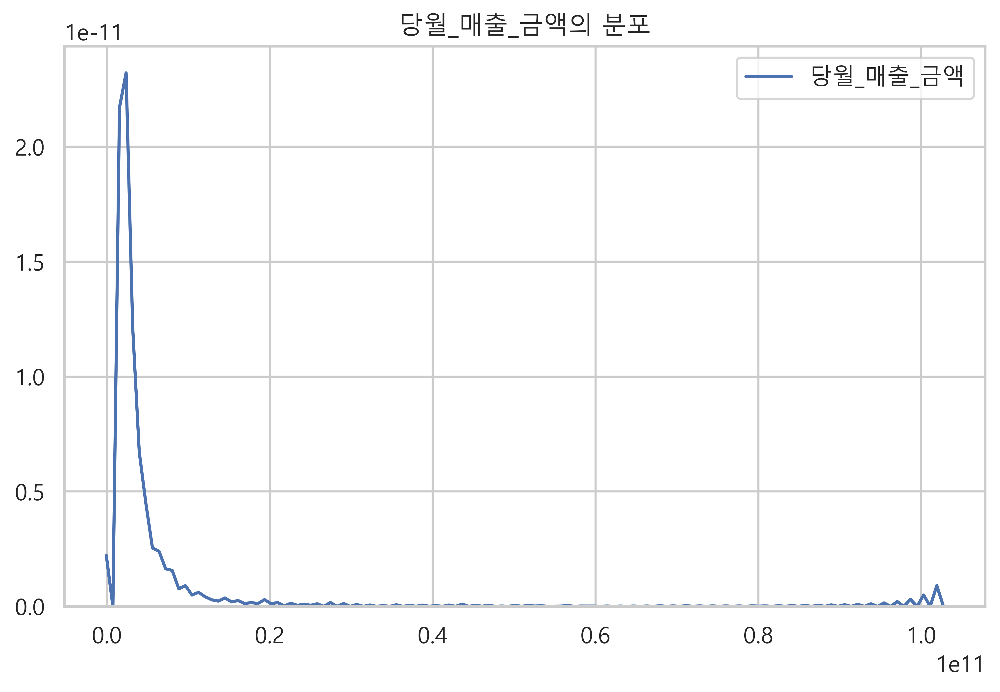

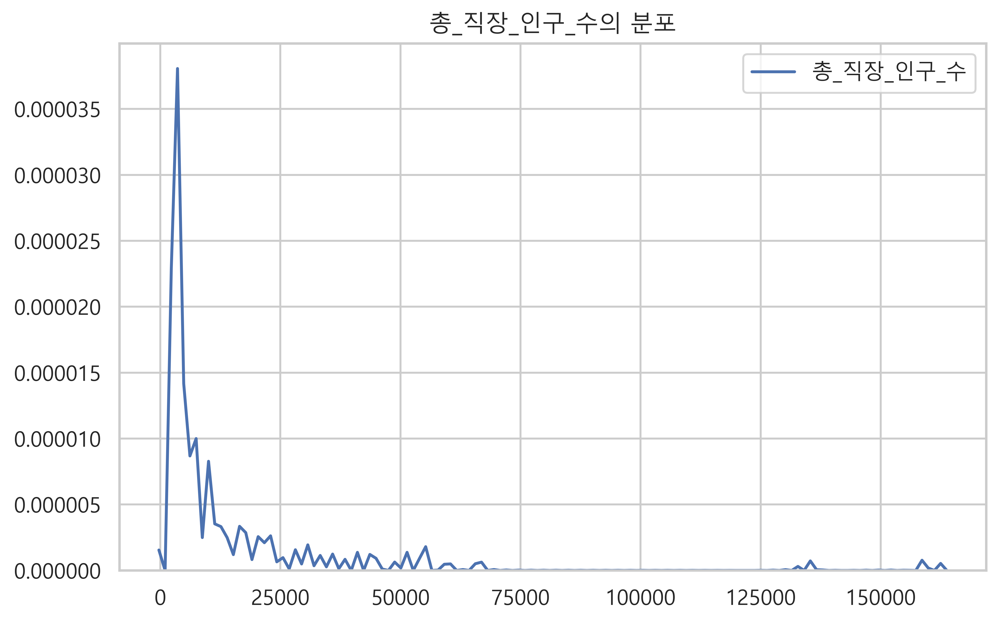

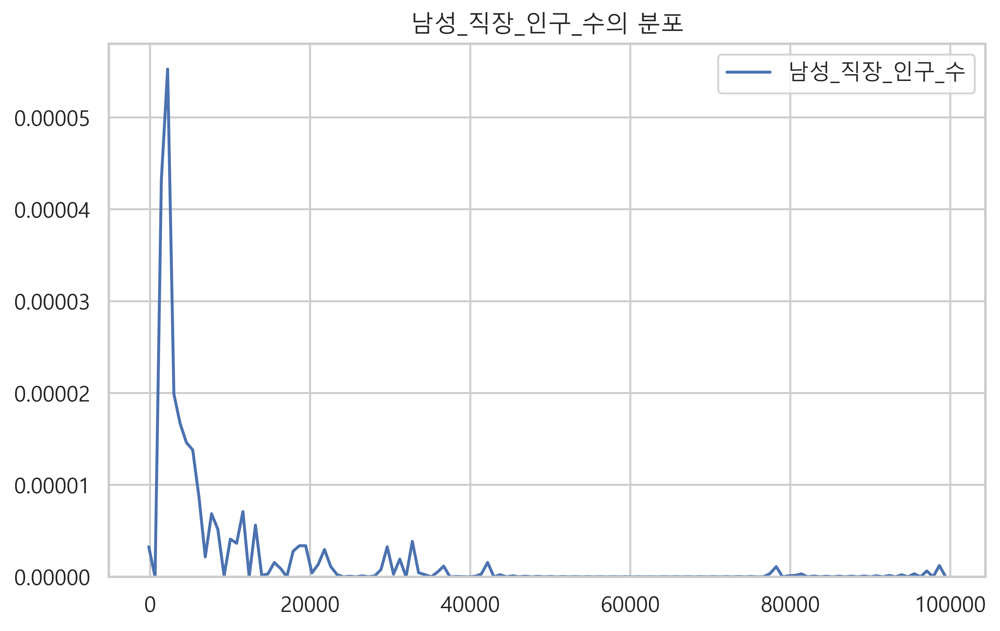

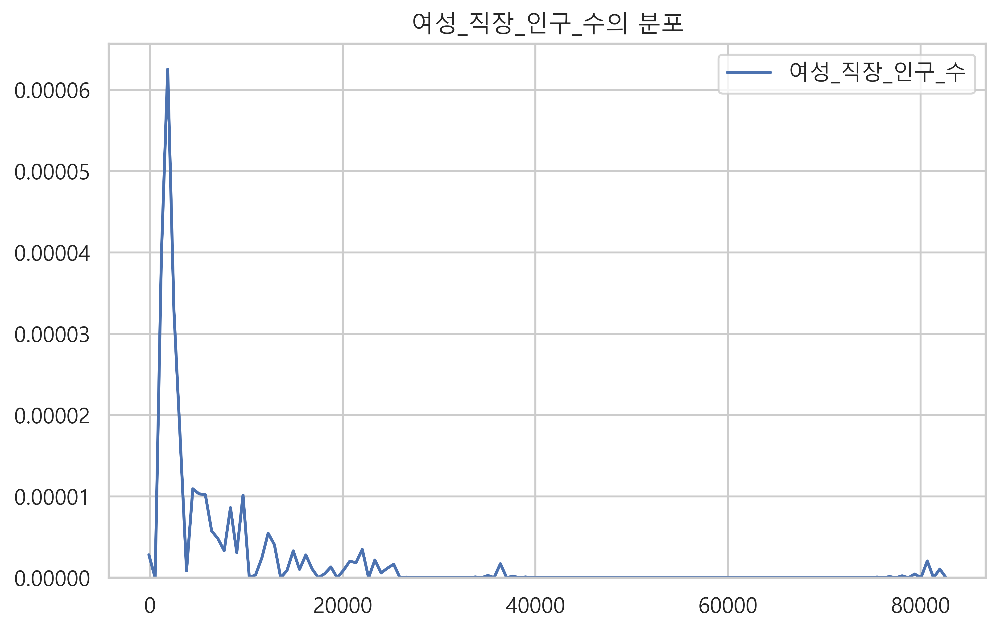

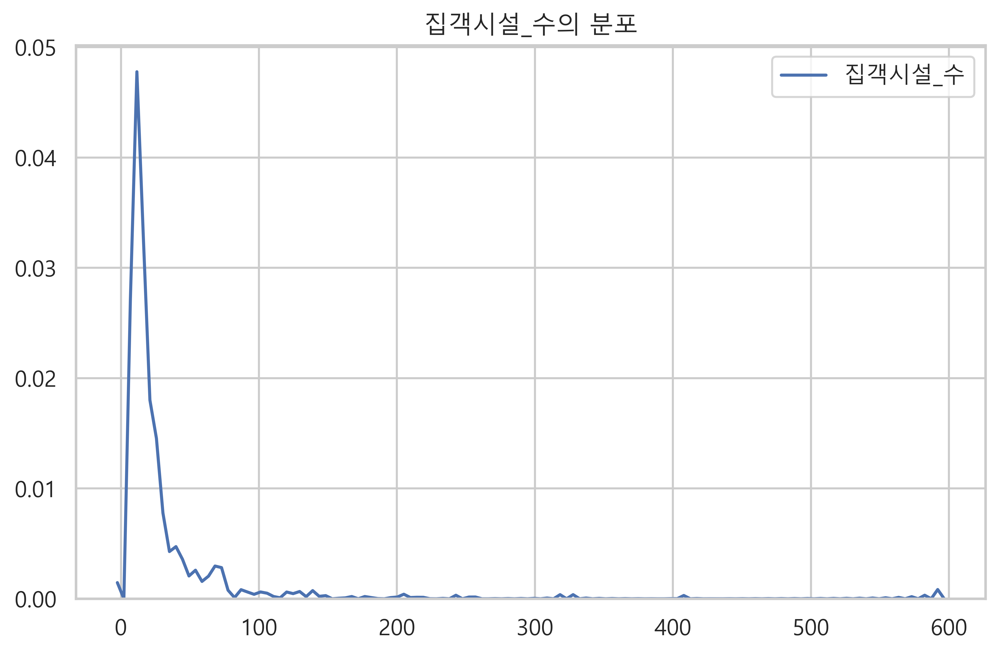

...

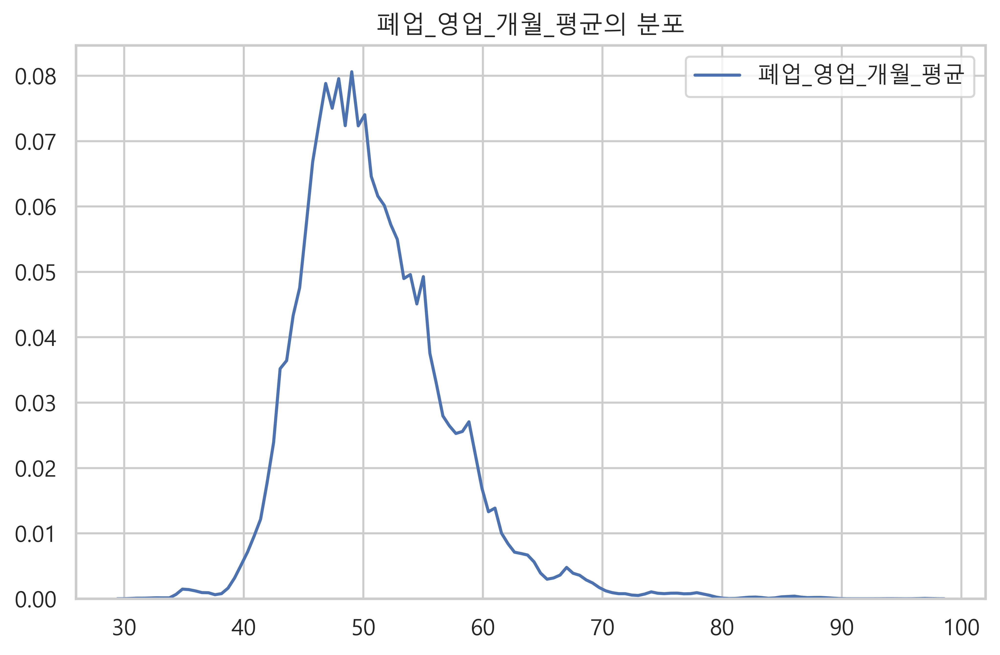

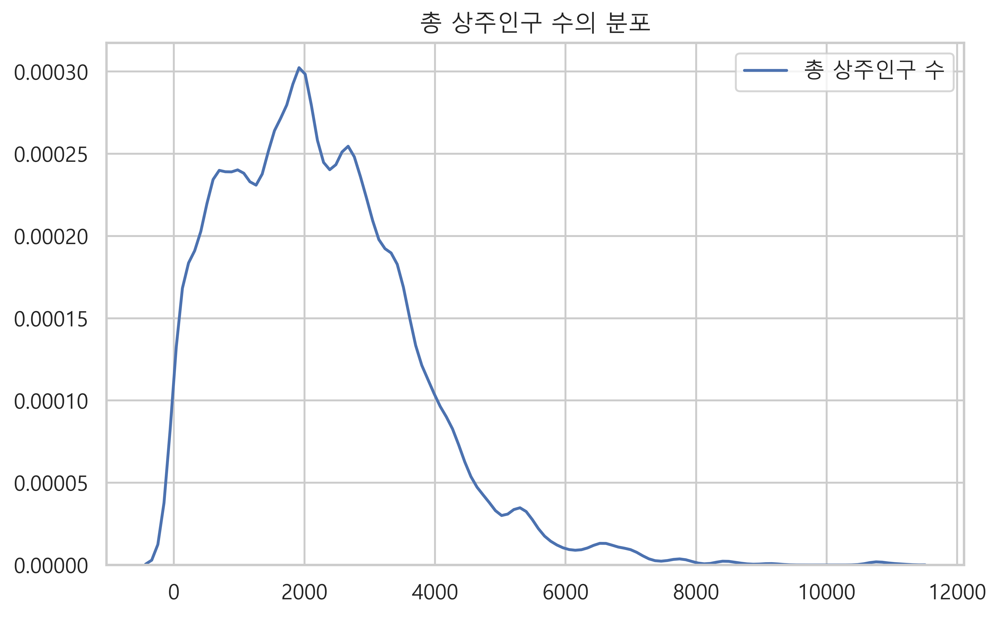

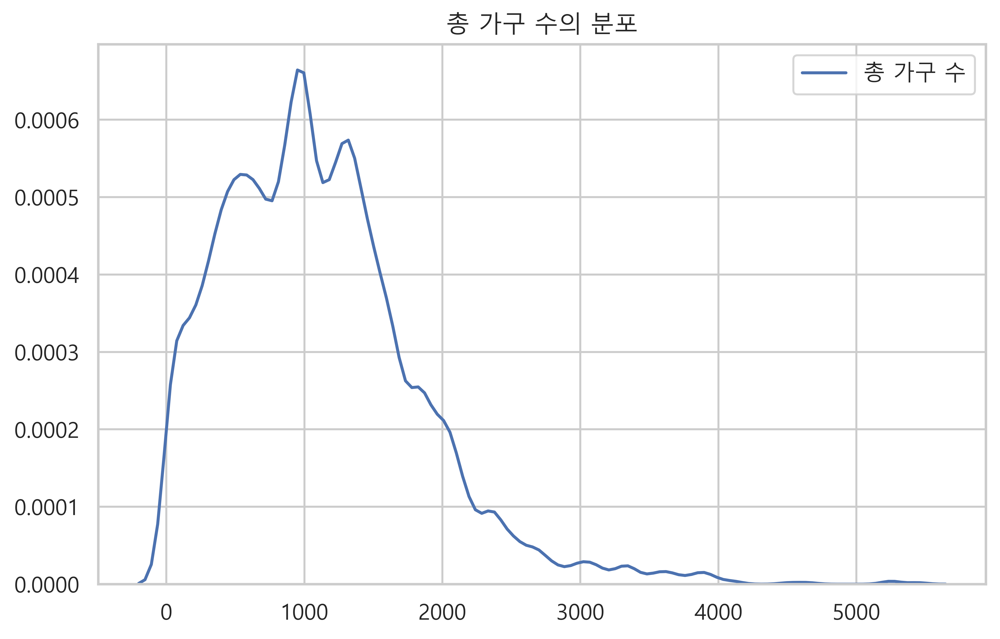

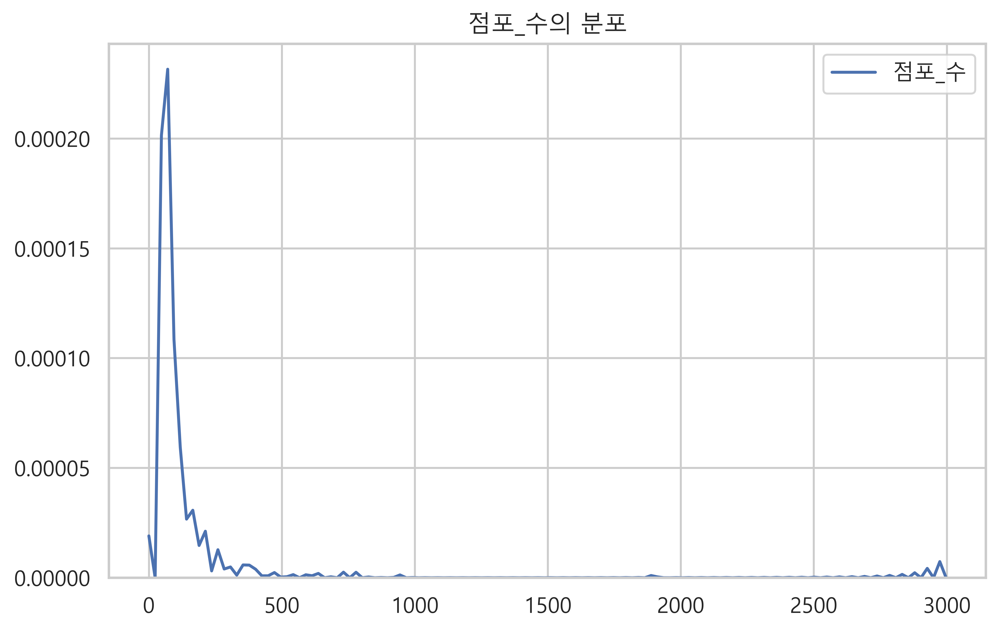

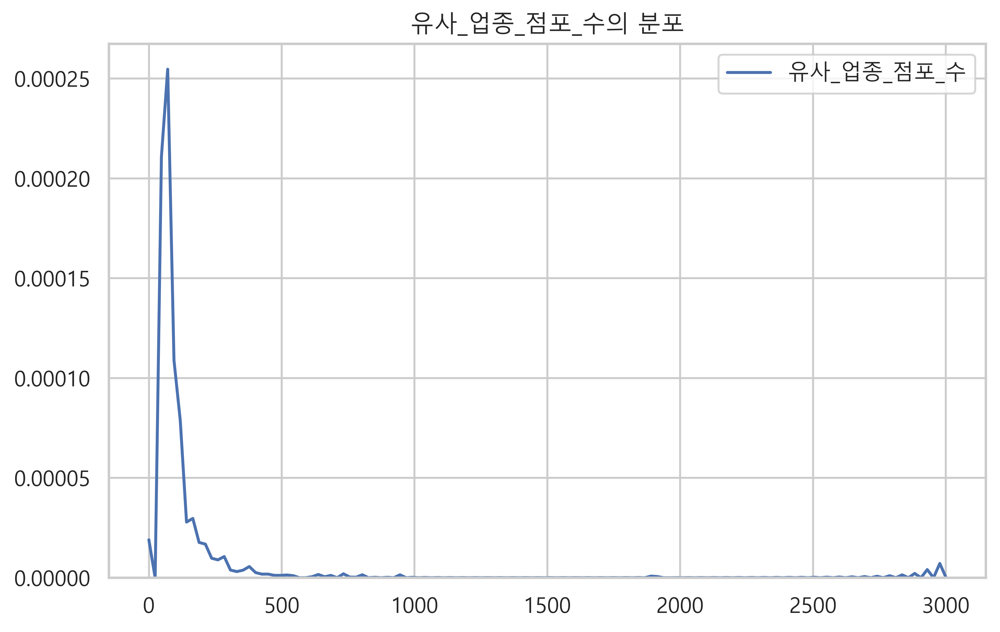

In [81]:
for col in s_df.columns[4:]:
    sns.kdeplot(s_df[col])
    plt.title("{}의 분포".format(col))
    plt.show()


In [14]:
sns.pairplot(s_df_result)
plt.show()

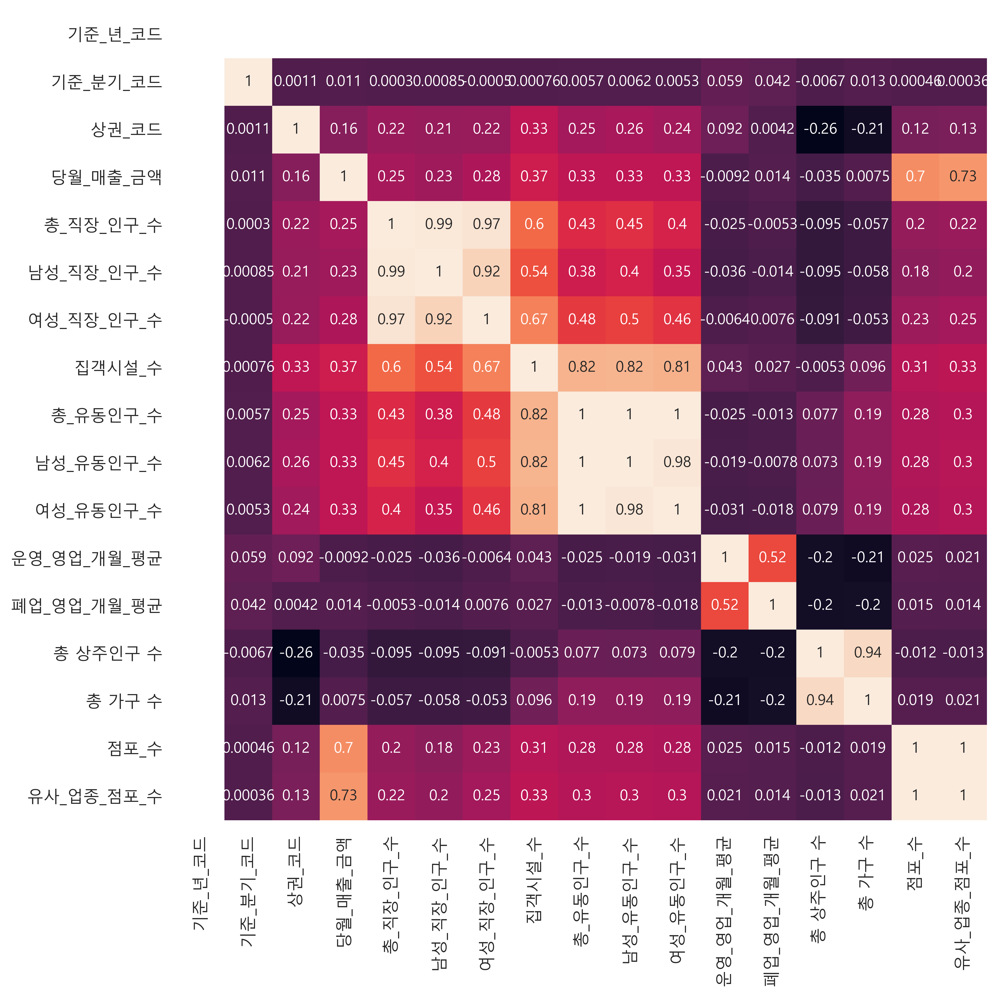

In [16]:
corr = s_df.corr()
plt.figure(figsize = (10,10))
sns.heatmap(data=corr, square=True , annot=True, cbar=False)
plt.show()

In [18]:
from sklearn.datasets import load_boston
dfX0 = pd.DataFrame(s_df, columns=s_df.columns[5:])
dfX = sm.add_constant(dfX0)
dfy = pd.DataFrame(s_df['당월_매출_금액'])

model = sm.OLS(dfy, dfX)
result = model.fit()
print(result.summary())

                            OLS Regression Results                            
Dep. Variable:               당월_매출_금액   R-squared:                       0.619
Model:                            OLS   Adj. R-squared:                  0.619
Method:                 Least Squares   F-statistic:                 1.741e+04
Date:                Wed, 27 Nov 2019   Prob (F-statistic):               0.00
Time:                        20:54:32   Log-Likelihood:            -2.8689e+06
No. Observations:              128761   AIC:                         5.738e+06
Df Residuals:                  128748   BIC:                         5.738e+06
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const        2.998e+07   2.97e+07      1.009      

In [20]:
s_df.describe().loc["std"]

기준_년_코드        0.000000e+00
기준_분기_코드       1.118300e+00
상권_코드          4.084478e+02
당월_매출_금액       1.859823e+09
총_직장_인구_수      1.027101e+04
남성_직장_인구_수     6.153170e+03
여성_직장_인구_수     4.327572e+03
집객시설_수         4.168177e+01
총_유동인구_수       5.809786e+05
남성_유동인구_수      2.857900e+05
여성_유동인구_수      2.977593e+05
운영_영업_개월_평균    1.817798e+01
폐업_영업_개월_평균    6.128392e+00
총 상주인구 수       1.439234e+03
총 가구 수         7.122739e+02
점포_수           2.773230e+01
유사_업종_점포_수     2.847419e+01
Name: std, dtype: float64

In [ ]:
rb = preprocessing.RobustScaler()
scaled =  pd.DataFrame(rb.fit_transform(df2[['carat','depth','table', "price", 'density']]),columns=['carat','depth','table', "price",'density'],index=df2.index)

df2[["carat", "depth", "table", "price", "density"]] = scaled[scaled.columns]

In [25]:
dfX2 = dfX.copy()
dfX2.columns

Index(['const', '총_직장_인구_수', '남성_직장_인구_수', '여성_직장_인구_수', '집객시설_수', '총_유동인구_수',
       '남성_유동인구_수', '여성_유동인구_수', '운영_영업_개월_평균', '폐업_영업_개월_평균', '총 상주인구 수',
       '총 가구 수', '점포_수', '유사_업종_점포_수'],
      dtype='object')